In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import os

# import helper function script
import script_EDA as scp

In [2]:
import os
os.listdir(r'C:\Users\julit\Downloads\Airbus-Dataset')
PATH = r'C:\Users\julit\Downloads\Airbus-Dataset'
msn_02_path = os.path.join(PATH, 'msn_02_fuel_leak_signals_preprocessed.csv')
msn_10_path = os.path.join(PATH, 'msn_10_fuel_leak_signals_preprocessed.csv')
msn_11_path = os.path.join(PATH, 'msn_11_fuel_leak_signals_preprocessed.csv')
msn_12_path = os.path.join(PATH, 'msn_12_fuel_leak_signals_preprocessed.csv')
msn_14_path = os.path.join(PATH, 'msn_14_fuel_leak_signals_preprocessed.csv')
msn_29_path = os.path.join(PATH, 'msn_29_fuel_leak_signals_preprocessed.csv')
msn_37_path = os.path.join(PATH, 'msn_37_fuel_leak_signals_preprocessed.csv')
msn_53_path = os.path.join(PATH, 'msn_53_fuel_leak_signals_preprocessed.csv')


In [3]:
df = pd.read_csv(msn_37_path,sep=';')

df.head()

,UTC_TIME,FUEL_USED_2,FUEL_USED_3,FUEL_USED_4,FW_GEO_ALTITUDE,VALUE_FOB,VALUE_FUEL_QTY_CT,VALUE_FUEL_QTY_FT1,VALUE_FUEL_QTY_FT2,VALUE_FUEL_QTY_FT3,VALUE_FUEL_QTY_FT4,VALUE_FUEL_QTY_LXT,VALUE_FUEL_QTY_RXT,FLIGHT_PHASE_COUNT,FUEL_USED_1,Flight,MSN
0,2016-07-27 13:31:37,NaN,NaN,NaN,36.0,19862.0,0.0,1928.0,2710.0,2560.0,1921.0,5405.0,5339.0,2.0,NaN,0.0,F-RBAJ
1,2016-07-27 13:31:38,NaN,NaN,NaN,38.0,19862.0,0.0,1928.0,2710.0,2560.0,1921.0,5405.0,5339.0,2.0,NaN,0.0,F-RBAJ
2,2016-07-27 13:31:39,NaN,NaN,NaN,38.0,19862.0,0.0,1928.0,2710.0,2561.0,1921.0,5406.0,5338.0,2.0,NaN,0.0,F-RBAJ
3,2016-07-27 13:31:40,NaN,NaN,NaN,35.0,19862.0,0.0,1928.0,2709.0,2561.0,1921.0,5405.0,5339.0,2.0,NaN,0.0,F-RBAJ
4,2016-07-27 13:31:41,NaN,NaN,NaN,36.0,19862.0,0.0,1928.0,2710.0,2561.0,1922.0,5405.0,5339.0,2.0,NaN,0.0,F-RBAJ


In [4]:
# Setting UTC_TIME as index
df['UTC_TIME'] = pd.to_datetime(df['UTC_TIME'])
df.set_index('UTC_TIME',inplace=True)
df.sort_index(inplace=True)
df.sample(10)

,FUEL_USED_2,FUEL_USED_3,FUEL_USED_4,FW_GEO_ALTITUDE,VALUE_FOB,VALUE_FUEL_QTY_CT,VALUE_FUEL_QTY_FT1,VALUE_FUEL_QTY_FT2,VALUE_FUEL_QTY_FT3,VALUE_FUEL_QTY_FT4,VALUE_FUEL_QTY_LXT,VALUE_FUEL_QTY_RXT,FLIGHT_PHASE_COUNT,FUEL_USED_1,Flight,MSN
UTC_TIME,,,,,,,,,,,,,,,,
2016-12-07 17:05:29,NaN,NaN,NaN,64.0,17238.0,0.0,1385.0,1976.0,2054.0,1409.0,5299.0,5116.0,6.0,NaN,127.0,F-RBAJ
2017-06-09 16:38:49,NaN,NaN,NaN,5985.0,10305.0,0.0,1408.0,2161.0,1962.0,1400.0,1744.0,1633.0,8.0,NaN,335.0,F-RBAJ
2016-10-29 07:50:42,NaN,NaN,NaN,24992.0,32717.0,303.0,1848.0,2687.0,2680.0,1952.0,11585.0,11663.0,8.0,NaN,76.0,F-RBAJ
2016-12-11 14:34:01,NaN,NaN,NaN,28981.0,27717.0,0.0,1994.0,2652.0,2483.0,1832.0,9215.0,9543.0,8.0,NaN,133.0,F-RBAJ
2016-12-27 08:40:04,NaN,NaN,NaN,30994.0,29162.0,0.0,1892.0,2534.0,2545.0,1904.0,10082.0,10208.0,8.0,NaN,171.0,F-RBAJ
2017-05-29 20:37:24,NaN,NaN,NaN,2503.0,14946.0,2.0,1514.0,1983.0,2024.0,1570.0,3907.0,3947.0,8.0,NaN,324.0,F-RBAJ
2016-11-16 16:55:09,NaN,NaN,NaN,-41.0,13235.0,0.0,1619.0,2042.0,2111.0,1415.0,2976.0,3074.0,10.0,NaN,102.0,F-RBAJ
2017-03-29 09:19:58,NaN,NaN,NaN,-279.0,21794.0,0.0,1381.0,2229.0,1967.0,1547.0,7392.0,7282.0,11.0,NaN,255.0,F-RBAJ
2018-01-10 09:17:15,138.956024,94.122047,850.50592,510.0,10598.0,186.0,1931.0,2664.0,2550.0,1810.0,995.0,467.0,2.0,871.497009,380.0,F-RBAJ


## Interpolate linear in the Values of Fuel Used


In [5]:
# df['FUEL_USED_1'] = df['FUEL_USED_1'].interpolate(method='time')
# df['FUEL_USED_2'] = df['FUEL_USED_2'].interpolate(method='time')
# df['FUEL_USED_3'] = df['FUEL_USED_3'].interpolate(method='time')
# df['FUEL_USED_4'] = df['FUEL_USED_4'].interpolate(method='time')
# df['VALUE_FOB'] = df['VALUE_FOB'].interpolate(method='time')




df['FUEL_USED_1'] = df.groupby('Flight')['FUEL_USED_1'].apply(scp.interpolate_group).values
df['FUEL_USED_2'] = df.groupby('Flight')['FUEL_USED_2'].apply(scp.interpolate_group).values
df['FUEL_USED_3'] = df.groupby('Flight')['FUEL_USED_3'].apply(scp.interpolate_group).values
df['FUEL_USED_4'] = df.groupby('Flight')['FUEL_USED_4'].apply(scp.interpolate_group).values

df['VALUE_FOB'] = df.groupby('Flight')['VALUE_FOB'].apply(scp.interpolate_group).values


## Filter only longer Fligths 

In [6]:
print(df['Flight'].nunique())
df = scp.longer_than_1_hour(df)
print(df['Flight'].nunique())

498
270


## Filter only Flights in the longest phase (8, cruise) 

In [7]:
print(df['Flight'].nunique())
df = scp.phase8(df)
print(df['Flight'].nunique())

270
265


## Create additional features, like total used, FOB expected and difference

In [8]:
df = scp.additional_features(df)

In [9]:
scp.plot_flights(df, random=True)

In [10]:
scp.plot_flights(df,flight=98)


# tbd: drop nans from the first and last of the flights, also outlier detection

## Treat Outliers as nulls, then interpolate due to linear relationship

In [59]:
df = scp.outliers_to_nan(df,'VALUE_FOB')
df = scp.outliers_to_nan(df,'FUEL_USED_1')
df = scp.outliers_to_nan(df,'FUEL_USED_2')
df = scp.outliers_to_nan(df,'FUEL_USED_3')
df = scp.outliers_to_nan(df,'FUEL_USED_4')



In [60]:
# df.dropna(inplace=True)

## Plot Flights

<Axes: xlabel='UTC_TIME'>

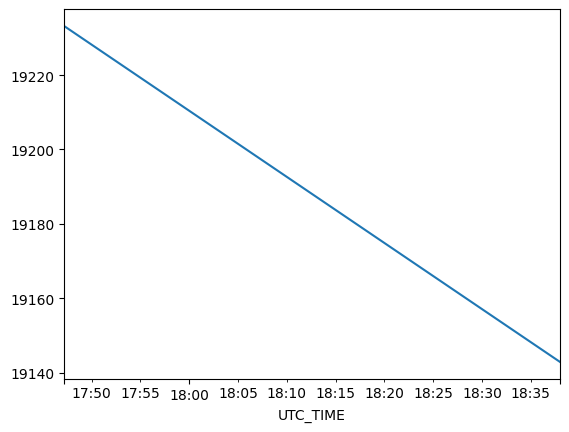

In [69]:
df[df['Flight']==91]['VALUE_FOB_EXPECTED'].plot()  

In [74]:
scp.plot_flights(df, random=True)

KeyError: 'VALUE_FOB_DIFF'

### Calculate Total_fuel_used handling NaN's in FUEL_USED_1, ...

In [52]:
#show summary ordered by missing_percentage_FUEL ascending
# summary.sort_values(by='missing_percentage_FOB', ascending=False)
scp.get_nan_summary(df).sort_values(by='missing_percentage_FOB', ascending=False)

,Flight,missing_count_FOB,total_count_FOB,missing_count_FUEL,total_count_FUEL,missing_percentage_FOB,missing_percentage_FUEL
0,11.0,0,7970,7970,0,0.0,100.0
183,1890.0,0,18781,18781,0,0.0,100.0
189,1930.0,0,18062,18062,0,0.0,100.0
188,1911.0,0,20858,20858,0,0.0,100.0
187,1908.0,0,12533,12533,0,0.0,100.0
...,...,...,...,...,...,...,...
98,1177.0,0,3874,3874,0,0.0,100.0
99,1183.0,0,20334,20334,0,0.0,100.0
100,1185.0,0,2744,2744,0,0.0,100.0
101,1188.0,0,7771,7771,0,0.0,100.0


## Remove flights which has more than 50% of nans in either VALUE_FOB or in TOTAL_FUEL_USED

## Gestion de outliers y Nans

In [32]:
# Reset index for plotting
df_filtered.reset_index(inplace=True)
df2 = df_filtered[df_filtered['Flight'].isin(['V0095'])]

# Plotting the data
fig = px.line(df2, x='UTC_TIME', y='VALUE_FOB', color='Flight')
fig.update_layout(title='VALUE_FOB by Flight over Time')


fig.show()

#set index back to UTC_TIME
df_filtered.set_index('UTC_TIME', inplace=True)

c:\ProgramData\anaconda3\Lib\site-packages\_plotly_utils\basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



Moving average


In [33]:
# Aplicar suavizado a las columnas
df_filtered['VALUE_FOB_smoothed'] = scp.moving_average(df_filtered, 'VALUE_FOB', 50)

df_filtered['TOTAL_FUEL_USED_smoothed'] = scp.moving_average(df_filtered, 'TOTAL_FUEL_USED', 50)

In [34]:
df_filtered['VALUE_FOB_smoothed']

UTC_TIME
2010-10-26 13:32:07    17585.520000
2010-10-26 13:32:08    17584.538462
2010-10-26 13:32:09    17583.629630
2010-10-26 13:32:10    17582.750000
2010-10-26 13:32:11    17581.931034
                           ...     
2017-01-23 20:17:44    17494.800000
2017-01-23 20:17:45    17494.172414
2017-01-23 20:17:46    17493.678571
2017-01-23 20:17:47    17493.222222
2017-01-23 20:17:48    17492.846154
Name: VALUE_FOB_smoothed, Length: 392343, dtype: float64

In [35]:
import plotly.graph_objects as go

# Reset index for plotting
df_filtered.reset_index(inplace=True)
df2 = df_filtered[df_filtered['Flight'].isin(['V0095'])]

# Crear la figura
fig = go.Figure()

# Añadir la serie original VALUE_FOB
fig.add_trace(go.Scatter(x=df2['UTC_TIME'], y=df2['VALUE_FOB'], mode='lines', name='VALUE_FOB'))

# Añadir la serie suavizada VALUE_FOB_smoothed
fig.add_trace(go.Scatter(x=df2['UTC_TIME'], y=df2['VALUE_FOB_smoothed'], mode='lines', name='VALUE_FOB_smoothed'))

# Configurar el layout
fig.update_layout(title='Comparación de VALUE_FOB y VALUE_FOB_smoothed por Flight over Time',
                  xaxis_title='UTC_TIME',
                  yaxis_title='VALUE_FOB',
                  legend_title='Series')

# Mostrar el gráfico
fig.show()

# Volver a establecer el índice a UTC_TIME
df_filtered.set_index('UTC_TIME', inplace=True)


c:\ProgramData\anaconda3\Lib\site-packages\_plotly_utils\basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



In [36]:
# Reset index for plotting
df_filtered.reset_index(inplace=True)
df2 = df_filtered[df_filtered['Flight'].isin(['V0095'])]

# Crear la figura
fig = go.Figure()

# Añadir la serie original VALUE_FOB
fig.add_trace(go.Scatter(x=df2['UTC_TIME'], y=df_filtered['VALUE_FOB_smoothed'].shift(1) - df_filtered['VALUE_FOB_smoothed'], mode='lines', name='VALUE_FOB'))

# Añadir la serie suavizada VALUE_FOB_smoothed
# fig.add_trace(go.Scatter(x=df2['UTC_TIME'], y=df2['VALUE_FOB_smoothed'], mode='lines', name='VALUE_FOB_smoothed'))

# Configurar el layout
fig.update_layout(title='Comparación de VALUE_FOB y VALUE_FOB_smoothed por Flight over Time',
                  xaxis_title='UTC_TIME',
                  yaxis_title='VALUE_FOB',
                  legend_title='Series')

# Mostrar el gráfico
fig.show()

# Volver a establecer el índice a UTC_TIME
df_filtered.set_index('UTC_TIME', inplace=True)
# plot 

c:\ProgramData\anaconda3\Lib\site-packages\_plotly_utils\basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



In [38]:
df_filtered[['TOTAL_FUEL_USED_smoothed','TOTAL_FUEL_USED']][df_filtered['Flight'] == 'V0095'].head()

,TOTAL_FUEL_USED_smoothed,TOTAL_FUEL_USED
UTC_TIME,,
2010-10-27 07:57:51,1473.852736,1453.6001
2010-10-27 07:57:52,1474.696308,1455.3725
2010-10-27 07:57:53,1475.537126,1457.0195
2010-10-27 07:57:54,1476.375632,1458.6643
2010-10-27 07:57:55,1477.217721,1460.2824


In [ ]:
df_filtered['DIFF_FOB'] = df_filtered['VALUE_FOB'].shift(1) - df_filtered['VALUE_FOB']
df_filtered['VALUE_FOB'].describe()

count    392343.000000
mean      18365.019666
std        7192.803819
min           0.000000
25%       12921.000000
50%       17527.000000
75%       23413.000000
max       39504.000000
Name: VALUE_FOB, dtype: float64